# Import Libraries

This part of code will import all the necessary libraries required for the code

In [1]:
from pyDTDM import *
from pyDTDM.utils import readcpt
import warnings
warnings.filterwarnings("ignore", category=UserWarning)
import yaml
try:
    from yaml import Cloader as Loader
except ImportError:
    from yaml import Loader

from adjustText import adjust_text
from shapely.geometry import LineString
from joblib import Parallel, delayed
import pandas as pd

import matplotlib.cm as cm
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

import os, sys
import cartopy.crs as ccrs
import pygmt
import xarray as xr

/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.


# Load Input File

The input file can be changed to include other parameters as well

In [2]:
config_file="InputFiles/InputFiles.yaml"
with open(config_file) as f:
    PARAMS = yaml.load(f, Loader=Loader)
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(" Parameters set from %s" % config_file)
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")


––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
 Parameters set from InputFiles/InputFiles.yaml
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 


### Reading the input file

In [3]:
# Input Files 
MODEL_NAME=PARAMS['InputFiles']['plate_kinematics']['model_name'] # model name
MODEL_DIR = PARAMS['InputFiles']['plate_kinematics']['model_dir']  ## plate model location
topology_filenames =[f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['plate_kinematics']['topology_files']]
rotation_filenames = [f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['plate_kinematics']['rotation_files']]
agegrid=PARAMS['InputFiles']['plate_kinematics']['agegrid'] ## agegrid location

ETOPO_FILE=PARAMS['InputFiles']['Raster']['ETOPO_FILE'] # ETOPO grid in meters (can be netCDf or GeoTiff)
ETOPO_Type=PARAMS['InputFiles']['Raster']['Raster_type']

SLAB2_FILE=PARAMS['InputFiles']['Raster']['SLAB2_FILE'] # SLAB2 grid in meters (can be netCDf or GeoTiff)
coastlines = f"{MODEL_DIR }/{PARAMS['InputFiles']['plate_kinematics']['coastline_file']}"
static_polygon_file=f"{MODEL_DIR }/{PARAMS['InputFiles']['plate_kinematics']['static_polygon']}"
static_polygons = pygplates.FeatureCollection(static_polygon_file)
continents=f"{MODEL_DIR }/{PARAMS['InputFiles']['plate_kinematics']['continents']}"
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print("Reading input file..... \n")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"Plate Model: {MODEL_NAME} \n")
print(f"Model Directory: {MODEL_DIR} \n")
print(f"Coastlines: {coastlines} \n")
print(f"Continents: {continents} \n")
print(f"Static Polygons: {static_polygon_file} \n")
print(f"Model Agegrid: {agegrid} \n")
print(f"ETopo grid: {ETOPO_FILE} \n")
print(f"Slab2 grid: {SLAB2_FILE}")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– \n")

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Reading input file..... 

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Plate Model: Zahirovic_etal_2022_GDJ_NNR 

Model Directory: ../../../PlateReconstruction 

Coastlines: ../../../PlateReconstruction/StaticGeometries/Coastlines/Global_coastlines_low_res.shp 

Continents: ../../../PlateReconstruction/StaticGeometries/ContinentalPolygons/Global_EarthByte_GPlates_PresentDay_ContinentalPolygons.shp 

Static Polygons: ../../../PlateReconstruction/StaticGeometries/StaticPolygons/Global_EarthByte_GPlates_PresentDay_StaticPlatePolygons.shp 

Model Agegrid: ../../../PlateReconstruction/SeafloorAgegrid 

ETopo grid: ../../../ETOPO/Smoothed Etopo.tif 

Slab2 grid: ../../../PlateReconstruction/Rasters/Slab2/Slab2_compiled_dip.nc
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 



### Setting model parameters

In [4]:
Paleomag_ID=PARAMS['Parameters']['paleomag_id']
Mantle_ID=PARAMS['Parameters']['mantle_optimised_id']

#The initial positions of crustal points are evenly distributed within the designated region. 
# At mesh refinement level zero, the points are approximately 20 degrees apart.
# Each increase in the density level results in a halving of the spacing between points.
MESH_REFINEMENT_LEVEL=PARAMS['Parameters']['mesh_refinement_level']  # higher refinement level will take longer time to run for optimisation 
WINDOW_SIZE=int(PARAMS['Parameters']['time_window_size'])
Weighted=PARAMS['Parameters']['weighted_mean']


NETCDF_GRID_RESOLUTION=PARAMS['GridParameters']['grid_spacing']  # in degree
ZLIB=PARAMS['GridParameters']['compression']['zlib'] 
COMPLEVEL=PARAMS['GridParameters']['compression']['complevel'] 

FROM_TIME=int(PARAMS['TimeParameters']['time_max']) ### end time
TO_TIME=int(PARAMS['TimeParameters']['time_min'])  ### start time
TIME_STEPS=int(PARAMS['TimeParameters']['time_step'])




parallel=PARAMS['Parameters']['number_of_cpus']### No of core to use or None for single core


print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print("The following parameters are set-")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"NNR Mantle Reference Frame ID: {Mantle_ID}")

print(f"Moving Window Size: {WINDOW_SIZE}")
print(f"Weighted Mean: {Weighted}")

print(f"Mesh Refinement Level: {MESH_REFINEMENT_LEVEL}")
print(f"NetCDF GRID Resolution: {NETCDF_GRID_RESOLUTION}")
print(f"NetCDF Compression Level: {COMPLEVEL} \n")
print(f"Model Start Time: {FROM_TIME}")
print(f"Model End Time: {TO_TIME}")
print(f"Model Time Step: {TIME_STEPS}\n")


print(f"Number of CPU: {parallel}") # -1 means all the freely available CPU


print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
The following parameters are set-
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
NNR Mantle Reference Frame ID: 666666
Moving Window Size: 15
Weighted Mean: True
Mesh Refinement Level: 9
NetCDF GRID Resolution: 0.1
NetCDF Compression Level: 5 

Model Start Time: 125
Model End Time: 0
Model Time Step: 1

Number of CPU: -1
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 


### Creating Output File

The output will be stored in the output folder: Paleotopography

There will be two folder:
- CSV Folder: to store data in tabular format. Here I have used paraquet file because it reduces the storage 
- Figure Folder: to store plot generated in the notebook

In [5]:
# Output Directory
OUTPUT_FOLDER=PARAMS['OutputFiles']['output_dir']

DEFAULT_OUTPUT_CSV=os.path.join(OUTPUT_FOLDER,'CSV')  # folder to store output in Tabular format
DEFAULT_OUTPUT_Figure=os.path.join(OUTPUT_FOLDER,'Figure')




print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"All the output will be saved in {OUTPUT_FOLDER}")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
create_directory_if_not_exists(OUTPUT_FOLDER)
create_directory_if_not_exists(DEFAULT_OUTPUT_CSV)
create_directory_if_not_exists(DEFAULT_OUTPUT_Figure)
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")


––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
All the output will be saved in ../../../EBM_Results
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Created directory: ../../../EBM_Results
Created directory: ../../../EBM_Results/CSV
Created directory: ../../../EBM_Results/Figure
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 


## Local Function for plotting

In [28]:
def plotgdf(gdf,gplot,column=None,mollweide=False,time=0,cbar=False,quick=True,**kwargs):

    '''This function can be used to plot the reconstructed geodataframe at any time along with topologies and 
    features. If the data is large it will take a lot of time to plot. Turn quick to True to plot the data faster.
    However, there may be some issues with the colors.

    gdf: gpd.GeoDataFrame
    model: gplatey.PlateReconconstruction
    column: name of the colum to be plotted (str)
    time: reconstruction time (int)
    cbar: whether to display colorbar

    '''
    
    cmap = kwargs.get('cmap', None)
    vmin = kwargs.get('vmin', None)
    vmax = kwargs.get('vmax', None)
    label = kwargs.get('label', None)
    title=kwargs.get('title', None)
    features=kwargs.get('features',True)
    color=kwargs.get('color',None)
    markersize=kwargs.get('markersize',10)
    orientation=kwargs.get('orientation','vertical')
    shrink=kwargs.get('shrink',0.5)
    extend=kwargs.get('extend',None)
    
    central_longitude=kwargs.get('central_longitude',0)
    figsize=kwargs.get('figsize',(12,8))
    
    
    
    
    
    
    fig = plt.figure(figsize=figsize, dpi=300)
    # gplot = gplately.PlotTopologies(model, coastlines=model.coastlines, continents=model.continents, time=time)

    if mollweide:
        ax = fig.add_subplot(111, projection=ccrs.Mollweide(central_longitude = central_longitude))
        ax.gridlines(color='0.7',linestyle='--', xlocs=np.arange(-180,180,30), ylocs=np.arange(-90,90,30))
    
        mollweide_proj = f"+proj=moll +lon_0={central_longitude} +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
        gdf=gdf.to_crs(mollweide_proj)
    else:
        ax = fig.add_subplot(111, projection=ccrs.PlateCarree(central_longitude = central_longitude))
        ax.gridlines(color='0.7',linestyle='--', xlocs=np.arange(-180,180,15), ylocs=np.arange(-90,90,15))
    
        
        
    if features:
    
        # Plot shapefile features, subduction zones and MOR boundaries at time Ma
        gplot.time = time # Ma
        gplot.plot_continents(ax, facecolor='grey', alpha=0.2)
        gplot.plot_coastlines(ax, color='skyblue',alpha=0.3)
        gplot.plot_ridges_and_transforms(ax, color='k')
        gplot.plot_trenches(ax, color='k')
        gplot.plot_subduction_teeth(ax, color='k')

        gplot.plot_ridges(ax, color='k')
        gplot.plot_transforms(ax, color='k')
        gplot.plot_misc_boundaries(ax, color='k')

    
        # Plot the GeoDataFrame
    
    if quick:
        da=df_to_NetCDF(x=gdf["Longitude"],y=gdf["Latitude"],z=gdf[column],grid_resolution=0.2)
        plot=gplot.plot_grid(ax=ax, grid=da,**{'cmap':cmap,'vmax':vmax,'vmin': vmin})
    else:
        plot = gdf.plot(ax=ax, cmap=cmap, column=column,vmax=vmax,vmin=vmin,color=color,markersize=markersize)
    

                                             # 'label':f'{column}'})
    if cbar:
        # Create a ScalarMappable object
        sm = cm.ScalarMappable(cmap=cmap)
        sm.set_array(gdf[column])
        sm.set_clim(vmin, vmax)
        
        # Add colorbar using the same Axes object used for plotting
        colorbar = plt.colorbar(sm, ax=ax, orientation=orientation,shrink=shrink,extend=extend, label=label)
        colorbar.set_label(label)
    
    ax.set_global()
    
    return ax    

# Define Plate Reconstruction

class PlateKinematicsParameters can be used to define plate kinematics parameters. To know more about class you can use `help` functions. For e.g. help(PlateKinematicsParameters) 

In [6]:

PK=PlateKinematicsParameters(topology_filenames, 
                             rotation_filenames,
                             static_polygons,
                             agegrid=agegrid,
                             coastlines=coastlines,
                             continents=continents,
                             anchor_plate_id=Mantle_ID)

time = 0 #Ma
gplot = gplately.PlotTopologies(PK.model, coastlines=coastlines, continents=continents, time=time) ##gplately plotting object


# Tessellate Subduction Zones and Fetch Associated Parameters

This section tessellates all subduction zones into points and computes the associated subduction parameters using the `PlateKinematicsParameters.get_subductiondf()` function.  
The results are saved as Parquet files, so you do **not** need to rerun this block multiple times.


In [7]:
list_subduction_df=[]
for reconstruction_time in range (TO_TIME,FROM_TIME,TIME_STEPS):
   
    subduction_df=PK.get_subductiondf(reconstruction_time,  
                                      tessellation_threshold_deg=NETCDF_GRID_RESOLUTION,
                                      velocity_delta_time=TIME_STEPS)
    subduction_df["Time"]=reconstruction_time
    list_subduction_df.append(subduction_df)

all_sz_df=pd.concat(list_subduction_df)
all_sz_df.to_parquet(f"{DEFAULT_OUTPUT_CSV}/ALL_Subduction.paraquet")

Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_0Ma.nc
Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_1Ma.nc
Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_2Ma.nc
Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_3Ma.nc
Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_4Ma.nc
Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_5Ma.nc
Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_6Ma.nc
Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_7Ma.nc
Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_8Ma.nc
Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_9Ma.nc
Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_

#### Read the subduction file once all subduction zone has been tessellated 

In [8]:
all_sz_df=pd.read_parquet(f"{DEFAULT_OUTPUT_CSV}/ALL_Subduction.paraquet") 

In [9]:
print("Columns in the DataFrame:")
for col in all_sz_df.columns:
    print(f"- {col}")


Columns in the DataFrame:
- Trench Latitude
- Trench Longitude
- Convergence Rate
- Migration Rate
- Subduction Velocity
- Obliquity Angle
- Subduction Normal Angle
- Subduction Length
- Subduction Plate Velocity
- Subduction Plate Obliquity
- vratio
- Nearest Trench Edge
- Start Edge Trench
- Convergence Velocity Orthogonal
- Convergence Velocity Parallel
- Trench Velocity Orthogonal
- Trench Velocity Parallel
- Subducting Velocity Orthogonal
- Subducting Velocity Parallel
- Subducting Plate ID
- Trench Plate ID
- geometry
- Subduction Volume Rate
- Plate Thickness
- Subduction Flux
- Time


## Plotting Subduction Parameters at a Specific Time

This section visualizes the subduction parameters for a given timestep.  
You can use it to inspect spatial distributions and trends in the data before further analysis.


Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_0Ma.nc


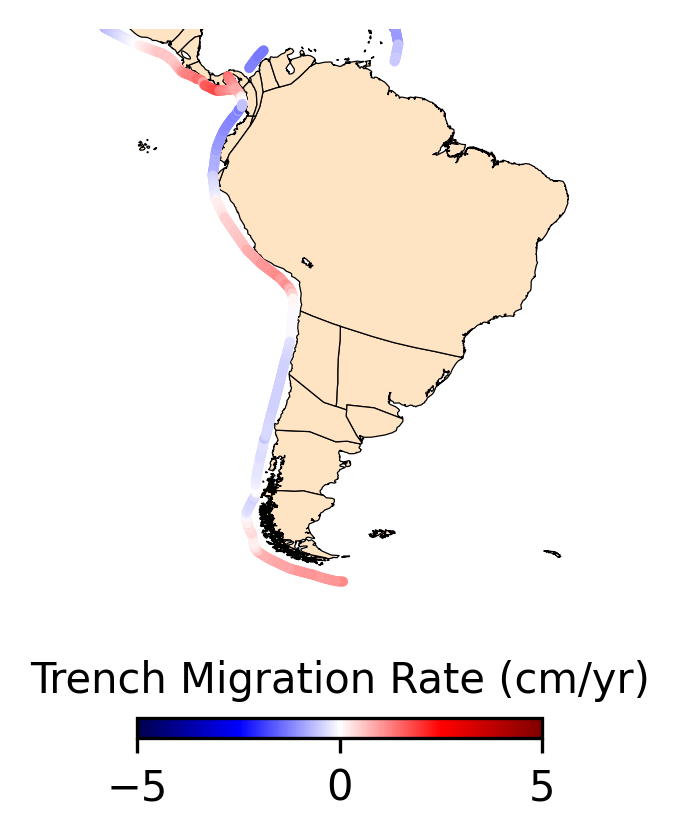

In [10]:

# ----------------------------
# Parameters
# ----------------------------
time = 0
dpi = 300
figsize = (3, 3)

# Load coastlines
coastlines_gdf = gpd.read_file(coastlines)

# Load colormap
delta = get_cpt.get_cmap("BlueDarkRed18.cpt") ### if you get error use default matplotlib cpt

# Load subduction data at the given time
df = PK.get_subductiondf(time)

# Convert migration rate from cm/yr
df['Migration Rate (cm/yr)'] = df['Migration Rate'] * 100

# ----------------------------
# Plot
# ----------------------------
fig, ax = plt.subplots(1, 1, figsize=figsize, dpi=dpi)

# Plot coastlines
coastlines_gdf.plot(
    ax=ax,
    facecolor='bisque',
    edgecolor='k',
    linewidth=0.3,
    alpha=1.0
)

# Plot migration rate
df.plot(
    ax=ax,
    column='Migration Rate (cm/yr)',
    cmap='seismic',
    markersize=2,
    legend=True,
    legend_kwds={
        'orientation': "horizontal",
        'shrink': 0.5
    },
    vmax=5,
    vmin=-5
)

# Axis settings
ax.set_xlim([-100, -30])
ax.set_ylim([-60, 15])
ax.axis('off')  # Turn off axes

plt.tight_layout()

# Adjust colorbar
cb = ax.get_figure().axes[-1]  # Access the colorbar axis
cb.tick_params(labelsize=10)   # Tick label size
cb.set_title("Trench Migration Rate (cm/yr)", fontsize=10)  # Title size

# Optional: Save figure
# plt.savefig(f"{DEFAULT_OUTPUT_Figure}/Andes_MR_{time}.png", transparent=True)

plt.show()


# Filtering Mountains at Subduction Zones

This step filters mountain data within the subduction zones.  
The unprocessed results will be saved as Parquet files. Note that this operation can take a significant amount of time when running at high spatial resolution.


In [11]:
GMBA_file=PARAMS['InputFiles']['Area_of_Interest']
GMBA=gpd.read_file(GMBA_file) ## this is a comprehensive database of all the mountains. 
## more details https://www.earthenv.org/mountains

In [12]:
### This is part of code filters GMBA mountains have active subduction. 

###
## Do not modify this part of code
####

# Define the number of steps and reconstruction time for the subduction profile analysis
n_steps = 10
reconstruction_time = 0

# Get the dataframe for subduction data at the given reconstruction time
# with a tessellation threshold (degree of accuracy for segmentation)
subduction_df = PK.get_subductiondf(reconstruction_time, tessellation_threshold_deg=0.7)

# Initialize lists to store subduction lines and their normal angles
subduction_lines = []
normal_angle = []

# Loop through subduction data and create lines between consecutive trench points
for i in range(0, len(subduction_df) - 1):
    # Extract longitude and latitude of two consecutive trench points
    Point1 = (subduction_df.iloc[i]['Trench Longitude'], subduction_df.iloc[i]['Trench Latitude'])
    Point2 = (subduction_df.iloc[i + 1]['Trench Longitude'], subduction_df.iloc[i + 1]['Trench Latitude'])
    
    # Create a line between the two points
    lines = LineString([Point1, Point2])
    
    # Calculate the distance between the two points
    dist = lines.length
    
    # Filter lines based on their distance (if too far apart, ignore them)
    if dist <= 5.0:
        subduction_lines.append(lines)  # Append line if the distance is below threshold

# Initialize lists for storing profiles and trench coordinates
profiles = []
trench_lats = []
trench_lons = []

# Create profiles (perpendicular lines) along the subduction zones
for i in range(0, len(subduction_df) - 1):
    # Calculate offsets (dlon1 and dlat1) based on subduction normal angle and steps
    dlon1 = n_steps * np.sin(np.radians(subduction_df.iloc[i]['Subduction Normal Angle']))
    dlat1 = n_steps * np.cos(np.radians(subduction_df.iloc[i]['Subduction Normal Angle']))
    
    # Get current trench point's coordinates
    x1 = subduction_df.iloc[i]['Trench Longitude']
    y1 = subduction_df.iloc[i]['Trench Latitude']
    
    # Calculate end point for the perpendicular profile line
    ilon1 = x1 + dlon1
    ilat1 = y1 + dlat1
    
    # Create start and end points for the profile line (a small offset and final point)
    start_point = Point(x1 + 0.1 * dlon1, y1 + 0.1 * dlat1)
    end_point = Point(ilon1, ilat1)
    
    # Create profile as a LineString and append it to profiles list
    profile = LineString([start_point, end_point])
    profiles.append(profile)
    
    # Save trench coordinates for later use
    trench_lats.append(y1)
    trench_lons.append(x1)

# Initialize lists to store intersected points, profiles, and trench coordinates
intersected_points = []
intersected_profiles = []
intersected_trench_lats = []
intersected_trench_lons = []

# Check intersection between profiles and subduction lines
for i in range(len(profiles)):
    for subduction_line in subduction_lines:
        # Get the intersection between profile and subduction line
        intersection = profiles[i].intersection(subduction_line)
        
        # If the intersection is a point, save the relevant information
        if intersection.geom_type == 'Point':
            intersected_profiles.append(profiles[i])
            intersected_trench_lats.append(trench_lats[i])
            intersected_trench_lons.append(trench_lons[i])
            intersected_points.append(intersection)

# Create a GeoDataFrame to store the intersection data
Intersection_df = gpd.GeoDataFrame()
Intersection_df['Trench Latitude I'] = intersected_trench_lats
Intersection_df['Trench Longitude I'] = intersected_trench_lons
Intersection_df['Intersection Point'] = intersected_points
Intersection_df['Intersection Profile'] = intersected_profiles

# Extract latitude and longitude from intersection points
Intersection_df['Intersection Latitude'] = Intersection_df['Intersection Point'].apply(lambda p: p.y)
Intersection_df['Intersection Longitude'] = Intersection_df['Intersection Point'].apply(lambda p: p.x)

# Set geometry of the GeoDataFrame for spatial operations
Intersection_df = Intersection_df.set_geometry(gpd.points_from_xy(Intersection_df['Trench Longitude I'], Intersection_df['Trench Latitude I']))

# Perform a spatial join to find nearest subduction points to the intersection
result = gpd.sjoin_nearest(subduction_df, Intersection_df, how='left', max_distance=0.1)
result = result.reset_index()

# Set the index and fill missing intersection lat/lon based on subduction normal angle
result = result.set_index('index')
result['Intersection Latitude'] = result['Intersection Latitude'].fillna(result['Trench Latitude'] + n_steps * np.cos(np.radians(result['Subduction Normal Angle'])))
result['Intersection Longitude'] = result['Intersection Longitude'].fillna(result['Trench Longitude'] + n_steps * np.sin(np.radians(result['Subduction Normal Angle'])))

# Initialize lists to store points for profiles
slats = []
slons = []


Slab2Raster=BhuRaster(folder_location=SLAB2_FILE,Raster_Type='DIP')

# Generate multiple points (e.g., 20) between intersection and trench points
num_points = 20
for idx, row in result.iterrows():
    # Generate lat/lon points evenly spaced between intersection and trench points
    latitudes = np.linspace(row['Intersection Latitude'], row['Trench Latitude'] + 0.5 * np.cos(np.radians(row['Subduction Normal Angle'])), num_points)
    longitudes = np.linspace(row['Intersection Longitude'], row['Trench Longitude'] + 0.5 * np.sin(np.radians(row['Subduction Normal Angle'])), num_points)
    
    # Append generated points to lists
    slats.extend(latitudes)
    slons.extend(longitudes)

# Convert lat/lon lists to a GeoDataFrame for spatial operations
points_gdf = gpd.GeoDataFrame({
    "Trench Latitude": slats,
    "Trench Longitude": slons,
    "geometry": latlonlist2point(slats, slons)  # Convert lat/lon to Point geometry
})

points_copy=points_gdf.copy()
# Rename the columns and reassign
points_copy = points_copy.rename(columns={
    "Trench Latitude": "Latitude",
    "Trench Longitude": "Longitude"
})

# points_copy=Slab2Raster.get_parameters(points_copy)
# # Rename columns back to the original names
# points_copy=points_copy.rename(columns={
#     "Latitude": "Trench Latitude",
#     "Longitude": "Trench Longitude"
# }, inplace=True)
# points_gdf=points_copy.drop(columns='DIP')
points_gdf = points_gdf.set_crs(epsg=4326)  # Set CRS to WGS84 (EPSG:4326)
print(points_gdf.head())


GMBAc1=GMBA[GMBA['Hier_Lvl']==3].copy() ### group of mountains 
GMBAc2=GMBA[GMBA['Hier_Lvl']==4].copy() ### mountains range


# points_gdf=gpd.GeoDataFrame(points,geometry=gpd.points_from_xy(points['Longitude'],points['Latitude']))
points_gdf=points_gdf.set_crs(DEFAULT_CRS)
point_within_continents = gpd.sjoin(points_gdf,GMBAc2, how='inner', predicate='within')
point_within_continents=point_within_continents.drop_duplicates()
name_list=point_within_continents['MapName'].unique()
filtered_df2 = GMBAc2[GMBAc2['MapName'].isin(name_list)] ## all the mountains range

# points_gdf=gpd.GeoDataFrame(points,geometry=gpd.points_from_xy(points['Longitude'],points['Latitude']))
points_gdf=points_gdf.set_crs(DEFAULT_CRS)
point_within_continents = gpd.sjoin(points_gdf,GMBAc1, how='inner', predicate='within')
point_within_continents=point_within_continents.drop_duplicates()
name_list=point_within_continents['MapName'].unique()
filtered_df1 = GMBAc1[GMBAc1['MapName'].isin(name_list)]  ##group of mountains


Using agegrid file : ../../../PlateReconstruction/SeafloorAgegrid/agegrid_final_mask_0Ma.nc
   Trench Latitude  Trench Longitude                    geometry
0        -1.606406        121.251299   POINT (121.2513 -1.60641)
1        -2.078663        121.087064  POINT (121.08706 -2.07866)
2        -2.550920        120.922828  POINT (120.92283 -2.55092)
3        -3.023177        120.758593  POINT (120.75859 -3.02318)
4        -3.495434        120.594358  POINT (120.59436 -3.49543)


In [13]:
print(f"Name of all mountains:{filtered_df2.MapName.unique()}")

Name of all mountains:['European Alps' 'Atlas Mountains' 'Alaska Range' 'Alborz Mountains'
 'Aleutian Ranges' 'Altiplano' 'Mexican Plateau' 'Apennine Mountains'
 'Balkan Mountains' 'Brooks Range' 'Cantabrian Mountains'
 'Carpathian Mountains' 'Cascade Range' 'Coast Mountains'
 'Cordillera Central' 'Cordillera de Guanacaste' 'Cordillera de Talamanca'
 'Cordillera de Mérida' 'Dinaric Alps' 'Trans-Mexican Volcanic Belt'
 'Greater Caucasus' 'Hamgyong Mountains' 'Sikhote-Alin' 'Pontic Mountains'
 'Lesser Caucasus' 'Mackenzie Mountains' 'Massif Central' 'Maya Mountains'
 'Rangnim Mountains' 'Olympic Mountains' 'Península de Azuero' 'Pyrenees'
 'Rif' 'Serranía del Baudó' 'Serranía de San Blas' 'Serranía de Tabasara'
 'Serranía del Sapo' 'Sierra de Ambato' 'Sierras de Córdoba'
 'Sierra de Famatina' 'Sierras de San Luis' 'Sierras de Valle Fertil'
 'Sierra de Velasco' 'Sierra del Nevado' 'Sierra Madre del Sur'
 'Sierra Madre Occidental' 'Sierra Madre Oriental' 'Sierra Nevada'
 'Sierra Nevada de 

## Manual Processing

This section handles polygons that are merged with GMBA polygons but do **not** lie on the overriding plate as defined by SLAB2.  
It allows for manual separation and correction of these mismatched polygons.


In [14]:
zag=filtered_df2[filtered_df2['MapName']=='Zagros Mountains'].copy()
# List of mountain ranges to filter out
mountain_ranges_to_exclude = [
    "Atlas Mountains",
    "Zagros Mountains",
    "Baetic System",
    "Pyrenees"
]

# Filter out rows where 'MapName' is in the list of mountain ranges to exclude
filtered_df2 = filtered_df2[~filtered_df2['MapName'].isin(mountain_ranges_to_exclude)]
filtered_df2.to_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl4.shp")
### Removing Zagros
remove_geometry=zag.geometry.iloc[0]
filtered_df1['geometry'] = filtered_df1['geometry'].apply(lambda geom: geom.difference(remove_geometry))
filtered_df1.to_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl3.shp")

## seperating New Guinea from Malay
New_Guinea=filtered_df2[filtered_df2['MapName']=='New Guinea'].copy()
remove_geometry=New_Guinea.geometry.iloc[0]
filtered_df1['geometry'] = filtered_df1['geometry'].apply(lambda geom: geom.difference(remove_geometry))
filtered_df1=pd.concat([filtered_df1,New_Guinea])
filtered_df1.to_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl3.shp")

/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/geopandas/geodataframe.py:1968: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/geopandas/geodataframe.py:1968: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


## Plotting the Filtered Mountains

In [15]:
# Define the groups and their symbols
groups = {
    'island arcs': 'o',   # Circle
    'noncollisional mountains': '^',   # Triangle
    'collisional mountains': 's'    # Rectangle
}
# vibrant blue
colorlist=["xkcd:lavender","xkcd:pink","xkcd:strong blue","xkcd:grapefruit","xkcd:neon purple","xkcd:bluish"]

# Define the colors for each group
group_colors = {
    'island arcs': colorlist,  # Distinct colors for island arcs
    'noncollisional mountains':colorlist,  # Distinct colors for noncollisional mountains
    'collisional mountains': colorlist  # Distinct colors for collisional mountains
}

# Define which mountains belong to which group
mountain_groups = {
    'Alaska-Yukon Ranges': 'noncollisional mountains',
    # 'Anatolian / Armenian Highlands': 'collisional mountains',
    'Balochistan Ranges': 'collisional mountains',
    'Caucasus Mountains': 'collisional mountains',
    'Central Andes': 'noncollisional mountains',
    'Hindu Kush': 'collisional mountains',
    'Iranian Plateau': 'collisional mountains',
    'Japanese Archipelago': 'island arcs',
    'Kamchatka Peninsula': 'island arcs',
    'Northern Andes': 'noncollisional mountains',
    'Pacific Coast Ranges':  'noncollisional mountains',
    'Solomon Islands': 'island arcs',
    'Lesser Antilles': 'island arcs',
    'South European Highlands': 'noncollisional mountains',
    'Southern Andes': 'noncollisional mountains',
       'Malay Archipelago':'island arcs'
}


Hindu Kush
Southern Andes
Central Andes
Northern Andes
Japanese Archipelago
Iranian Plateau
Pacific Coast Ranges
Kamchatka Peninsula
Malay Archipelago
Solomon Islands
Caucasus Mountains
Balochistan Ranges
Lesser Antilles
South European Highlands
Alaska-Yukon Ranges


/var/folders/qr/01bxwnvn05s319mx5c07sd7w0000gp/T/ipykernel_92015/545751423.py:45: DeprecationWarning: Deprecated! The 'plot_ridges_and_transforms' function will be removed in the future GPlately releases. Update your workflow to use the 'plot_ridges' and 'plot_transforms' functions instead, otherwise your workflow will not work with the future GPlately releases.


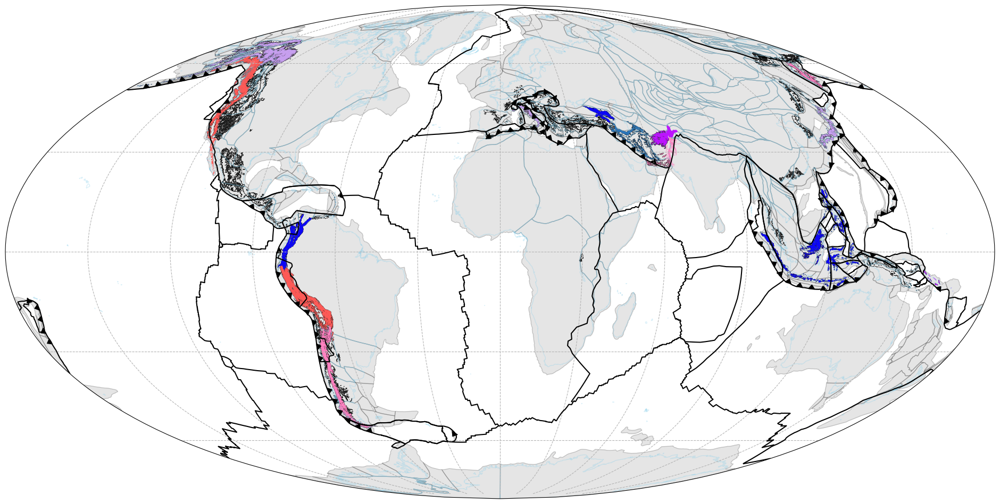

In [16]:

# If mollweide projection:
fig, ax = plt.subplots(1, 1, figsize=(24, 24), subplot_kw={'projection': ccrs.Mollweide(central_longitude=0)})
ax.gridlines(color='0.7', linestyle='--', xlocs=np.arange(-180, 180, 30), ylocs=np.arange(-90, 90, 30))

mollweide_proj = "+proj=moll +lon_0=0 +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
filtered_df2 = filtered_df2.to_crs(mollweide_proj)
filtered_df1 = filtered_df1.to_crs(mollweide_proj)
# Plot coastlines
filtered_df2.plot(ax=ax, facecolor='none', lw=0.4,alpha=1.0)

# plt.legend(handles=handles, loc='upper right')
test=filtered_df2[filtered_df2['MapName']=='New Guinea'].copy()
# test.plot(ax=ax,facecolor="xkcd:grapefruit",alpha=1.0)

# # Add polygons with colors based on group
for _, row in filtered_df1.iterrows():
    mountain_name = row['MapName']
    group = mountain_groups.get(mountain_name)
    if group:
        print(mountain_name)
        if mountain_name=="Iranian Plateau":
            result = row.geometry.difference(zag.geometry.iloc[0])
            
            color_idx = list(mountain_groups.keys()).index(mountain_name) % len(group_colors[group])
            color = group_colors[group][color_idx]
            ax.add_geometries([result], crs=ccrs.Mollweide(), facecolor=color, alpha=1.0)
        
        elif mountain_name=='Malay Archipelago':
            result = row.geometry.difference(test.geometry.iloc[0])
            color_idx = list(mountain_groups.keys()).index(mountain_name) % len(group_colors[group])
            color = group_colors[group][color_idx]
            ax.add_geometries([result], crs=ccrs.Mollweide(), facecolor=color, alpha=1.0)
            
        else:
            color_idx = list(mountain_groups.keys()).index(mountain_name) % len(group_colors[group])
            color = group_colors[group][color_idx]
            ax.add_geometries([row.geometry], crs=ccrs.Mollweide(), facecolor=color, alpha=1.0)


gplot.time = 0 # Ma
# gplot.plot_continent_ocean_boundaries(ax, color='b', alpha=0.05)
# gplot.plot_continents(ax, facecolor='palegoldenrod', alpha=0.2)
gplot.plot_continents(ax, facecolor='grey', alpha=0.2)
gplot.plot_coastlines(ax, color='skyblue',alpha=0.3)
gplot.plot_ridges_and_transforms(ax, color='k')
gplot.plot_misc_boundaries(ax,color='k')
gplot.plot_trenches(ax, color='k')
gplot.plot_subduction_teeth(ax, color='k')

# Create custom legend
handles = []
for group, symbol in groups.items():
    handle = mpatches.Patch(color=group_colors[group][0], label=group)  # Use the first color for the group
    handles.append(handle)

plt.savefig(f"{OUTPUT_FOLDER}/Figure/Studyarea.png")
plt.show()


### Alternative Plot (Time-Consuming)

This is a more detailed version of the previous plot.  
It takes a lot of time to run, so it can be skipped if speed is a concern.


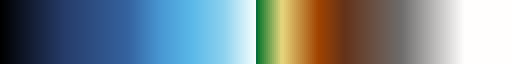

In [ ]:
##### cpt to matplotlib

# Generate PyGMT 'geo' colormap
pygmt.makecpt(cmap="geo", series=[-8000, 8000, 1], output="geo.cpt")

matplotlib_cmap=readcpt("geo.cpt")

matplotlib_cmap

xkcd:lavender
xkcd:pink
xkcd:strong blue
xkcd:grapefruit
xkcd:neon purple
xkcd:bluish
xkcd:lavender
xkcd:pink
xkcd:strong blue
xkcd:grapefruit
xkcd:lavender
xkcd:pink
xkcd:strong blue
xkcd:grapefruit
xkcd:neon purple


/var/folders/qr/01bxwnvn05s319mx5c07sd7w0000gp/T/ipykernel_80263/1824762348.py:71: DeprecationWarning: Deprecated! The 'plot_ridges_and_transforms' function will be removed in the future GPlately releases. Update your workflow to use the 'plot_ridges' and 'plot_transforms' functions instead, otherwise your workflow will not work with the future GPlately releases.


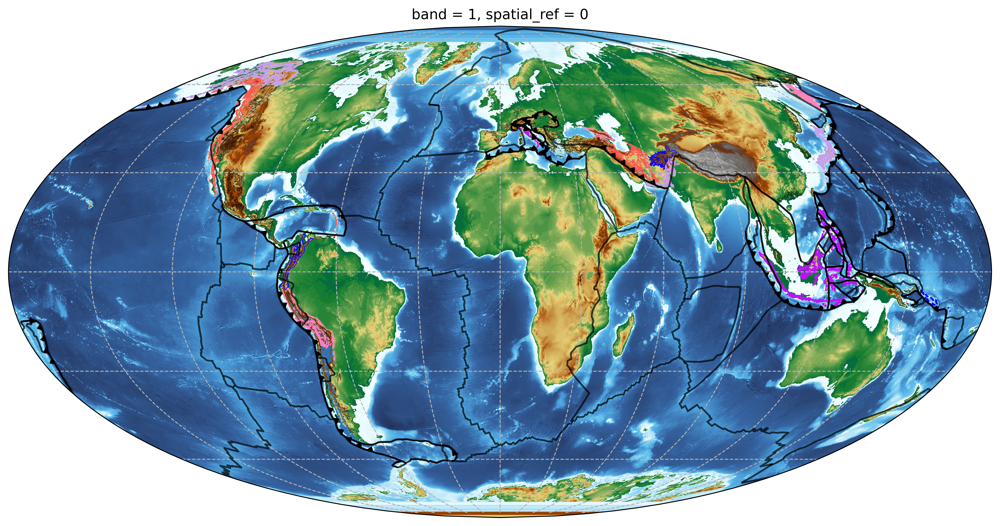

In [ ]:
# seafloor_age=xr.open_dataset(find_filename_with_number1(target_number=0,folder=agegrid))
topo=xr.open_dataset(ETOPO_FILE)
topo_coarse = topo.coarsen(x=5, y=5, boundary='pad').mean()

# If mollweide projection:
fig, ax = plt.subplots(1, 1, figsize=(15, 15),dpi=600, subplot_kw={'projection': ccrs.Mollweide(central_longitude=0)})
ax.gridlines(color='0.7', linestyle='--', xlocs=np.arange(-180, 180, 30), ylocs=np.arange(-90, 90, 30))

mollweide_proj = "+proj=moll +lon_0=0 +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
filtered_df2 = filtered_df2.to_crs(mollweide_proj)
filtered_df1 = filtered_df1.to_crs(mollweide_proj)

topo_coarse.band_data.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=8000,vmin=-8000,cmap=matplotlib_cmap, add_colorbar=False,robust=True,alpha=1.0)


filtered_df2.plot(ax=ax, facecolor='none', lw=0.3, alpha=0.5)

j=0
for i in range(len(mountain_groups.keys())):
    mts=list(mountain_groups.keys())[i]
    if mountain_groups[mts]=='noncollisional mountains':
        print(group_colors[mountain_groups[mts]][j])
        dfc=filtered_df1[ filtered_df1['MapName'].isin([mts])].copy()
        
        dfc.plot(ax=ax, transform=ccrs.Mollweide(),lw=0.5, edgecolor=group_colors[mountain_groups[mts]][j],facecolor='None', alpha=1.0)
        j+=1
j=0
for i in range(len(mountain_groups.keys())):
    mts=list(mountain_groups.keys())[i]
    if mountain_groups[mts]=='collisional mountains':
        print(group_colors[mountain_groups[mts]][j])
        dfc=filtered_df1[ filtered_df1['MapName'].isin([mts])].copy()
        
        dfc.plot(ax=ax, transform=ccrs.Mollweide(),lw=0.5, edgecolor=group_colors[mountain_groups[mts]][j],facecolor='None', alpha=1.0)
        j+=1
j=0
for i in range(len(mountain_groups.keys())):
    mts=list(mountain_groups.keys())[i]
    if mountain_groups[mts]=='island arcs':
        print(group_colors[mountain_groups[mts]][j])
        dfc=filtered_df1[ filtered_df1['MapName'].isin([mts])].copy()
        
        dfc.plot(ax=ax, transform=ccrs.Mollweide(), edgecolor=group_colors[mountain_groups[mts]][j],facecolor='None', alpha=1.0)
        j+=1


# Plot additional geographical features
gplot.time = 0 # Ma


# gplot.plot_continents(ax, facecolor='None', alpha=0.2)
# gplot.plot_coastlines(ax, color='None', alpha=0.3)
gplot.plot_ridges_and_transforms(ax, color='k',alpha=0.7)
# gplot.plot_plate_motion_vectors(ax, regrid_shape=15, alpha=0.5, color='black', zorder=2)
gplot.plot_trenches(ax, color='k')
gplot.plot_subduction_teeth(ax, color='k')
gplot.plot_misc_boundaries(ax,color='k',alpha=0.7)


plt.savefig(f"{OUTPUT_FOLDER}/Figure/Figure2a_new.png")
plt.show()


In [ ]:
del points_gdf, filtered_df1, filtered_df2, profiles, trench_lats, trench_lons,result, slats,slons

### it is good to delete object that are not going to be used to save space

## Creating Data for Our Model

**Note:** Here, "data" refers to sampled outputs from the Plate Reconstruction Model, Geodynamics Model, and Paleoclimate Model.  
Do **not** confuse this with the term "model" used elsewhere; in this context, "model" refers to our XAI (Explainable AI) model.


In [17]:
filtered_df=gpd.read_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl3.shp")
## In case you want to remove any mountain
# List of mountain ranges to filter out
mountain_ranges_to_exclude = [
    "Atlas Mountains",
    "Zagros Mountains",
    "Baetic System",
    "Pyrenees"
] ### same from previous list

filtered_df = filtered_df[~filtered_df['MapName'].isin(mountain_ranges_to_exclude)]
print(f"Number of Mountains: {len(filtered_df)}")
Arcs=filtered_df.copy()

Number of Mountains: 48


In [18]:
## We will create a bunch of points inside the mountains using pyDTDM.utils.multipoints_from_shape()
# Define a function to process each arc
## this may take some time. If there are lots of polygons
def process_arc(arc):
    _, lat, lon = multipoints_from_shape(arc)
    return lat, lon

# Parallel processing of arcs using joblib
results = Parallel(n_jobs=-1)(delayed(process_arc)(arc) for _, arc in Arcs.iterrows())

# Extract latitudes and longitudes from the results
lats = [lat for lat_list, _ in results for lat in lat_list]
lons = [lon for _, lon_list in results for lon in lon_list]

# Create the DataFrame
dataset = pd.DataFrame({'Longitude': lons, 'Latitude': lats})
dataset=dataset.drop_duplicates()

print(f"Total number of points in the database = {len(dataset)}")


/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to S

Total number of points in the database = 145515


In [19]:
# quickly check all the points. We will filter the points later
# plt.scatter(dataset['Longitude'],dataset['Latitude'],s=0.001)

### Creating GPlately Point Objects for Deep-Time Reconstruction

#### Notes:
- We currently have only ~140k points, so we are using the GPlately Points object.  
- For larger point sets, use `PK.create_points_around_trench` followed by `PK.get_mean_subduction`.  
- Processing very large point sets with the current method may freeze your computer, so proceed with caution.


In [20]:
## we will create gplately point object to reconstruct this points in deep time. This may take few minutes

warnings.filterwarnings("ignore", category=UserWarning)
gpts = PK.get_gpts_from_df(dataset)
training_data=f"{DEFAULT_OUTPUT_CSV}/Training_Data_Unprocessed" ## store the plate kinematics parameters
reconstruction_times = np.arange(TO_TIME, FROM_TIME)
create_directory_if_not_exists(training_data)
for rt in reconstruction_times:
    print(f"Starting Processing for Time={rt} Ma")
    reconstructed_subduction = all_sz_df[all_sz_df['Time']==rt].copy()
    reconstructed_subduction_gdf=gpd.GeoDataFrame(reconstructed_subduction,geometry=gpd.points_from_xy(reconstructed_subduction['Trench Longitude'],reconstructed_subduction['Trench Latitude']))
    reconstructed_subduction_gdf=reconstructed_subduction_gdf.set_crs(DEFAULT_CRS)
    print(f"Reconstructed Subduction Parameters for Time={rt} Ma")
    rlons, rlats = gpts.reconstruct(rt, return_array=True)
    reconstructed_df = gpd.GeoDataFrame({'Latitude': rlats, 'Longitude': rlons},geometry=gpd.points_from_xy(rlons,rlats))
    reconstructed_df=reconstructed_df.set_crs(DEFAULT_CRS)
    combined_df = sjoin_nearest_geodesic_points(reconstructed_df, reconstructed_subduction_gdf, distance_col='Trench Distance')
    combined_df=combined_df.to_crs(DEFAULT_CRS)
    print(f"Combining Data as a dataframe for Time={rt} Ma")
    combined_df.to_parquet(f"{training_data}/combined_df_{rt}.csv")

Created directory: ../../../EBM_Results/CSV/Training_Data_Unprocessed
Starting Processing for Time=0 Ma
Reconstructed Subduction Parameters for Time=0 Ma
Combining Data as a dataframe for Time=0 Ma
Starting Processing for Time=1 Ma
Reconstructed Subduction Parameters for Time=1 Ma
Combining Data as a dataframe for Time=1 Ma
Starting Processing for Time=2 Ma
Reconstructed Subduction Parameters for Time=2 Ma
Combining Data as a dataframe for Time=2 Ma
Starting Processing for Time=3 Ma
Reconstructed Subduction Parameters for Time=3 Ma
Combining Data as a dataframe for Time=3 Ma
Starting Processing for Time=4 Ma
Reconstructed Subduction Parameters for Time=4 Ma
Combining Data as a dataframe for Time=4 Ma
Starting Processing for Time=5 Ma
Reconstructed Subduction Parameters for Time=5 Ma
Combining Data as a dataframe for Time=5 Ma
Starting Processing for Time=6 Ma
Reconstructed Subduction Parameters for Time=6 Ma
Combining Data as a dataframe for Time=6 Ma
Starting Processing for Time=7 Ma


In [21]:
# Location for output
unprocessed_training_data=f"{DEFAULT_OUTPUT_CSV}/Training_Data_Unprocessed"
processed_training_data=f"{DEFAULT_OUTPUT_CSV}/Training_Data_Processed"
create_directory_if_not_exists(processed_training_data)

Created directory: ../../../EBM_Results/CSV/Training_Data_Processed


## Adding a Climate Model

**Note:** The Li paleoclimate model uses the Scotese Paleomap reconstruction.  
Therefore, its reference frame differs from that of Zahirovic et al. (2022). So we will need to use different reconstruction


In [22]:

CLIMATEMODEL_DIR=PARAMS['InputFiles']['precipitation']['model_dir']
CLIMATEMODEL_NAME=PARAMS['InputFiles']['precipitation']['model_name']

scotese_static_poly=f"{CLIMATEMODEL_DIR}/{PARAMS['InputFiles']['precipitation']['topology_files'][0]}"
scotese_rotation=f"{CLIMATEMODEL_DIR}/{PARAMS['InputFiles']['precipitation']['rotation_files'][0]}"

# Print inputs in a clear, copyable block
print("\n=== Input files for paleoclimate ===")
print(f"Climate model directory:  {CLIMATEMODEL_DIR}")
print(f"Climate model name:       {CLIMATEMODEL_NAME}")
print(f"PALEOMAP static polygons: {scotese_static_poly}  # .gpml")
print(f"PALEOMAP rotations:       {scotese_rotation}     # .rot")
print("=================================\n")

CM=ClimateParameters(topology_filenames, 
                             rotation_filenames,
                             static_polygons,
                             agegrid=agegrid,
                             coastlines=coastlines,
                             continents=continents,
                             anchor_plate_id=Paleomag_ID)



=== Input files for paleoclimate ===
Climate model directory:  ../../../PaleoClimateSimulations/ScotesePlateReconstruction
Climate model name:       PALEOMAP
PALEOMAP static polygons: ../../../PaleoClimateSimulations/ScotesePlateReconstruction/PALEOMAP_PlatePolygons.gpml  # .gpml
PALEOMAP rotations:       ../../../PaleoClimateSimulations/ScotesePlateReconstruction/PALEOMAP_PlateModel.rot     # .rot



### Sampling the Paleoclimate simulation at the same point at Plate Kinematics. 
This is may take few minutes

In [23]:

df=pd.read_parquet(f"{unprocessed_training_data}/combined_df_0.csv")
gpts_scotese=CM.get_gpts_from_df(df)

for t in reconstruction_times:
    print(f"Working on {t} Ma")
    rlons, rlats, indices = gpts_scotese.reconstruct(t,return_array=True,return_point_indices=True)
    coordinates = [(x, y) for x, y in zip(rlons, rlats)]
    raster_file = f"{PARAMS['InputFiles']['precipitation']['precipitation_folder']}/Precip_Li_et_al{t}.nc"
    ppt_data = rasterio.open(raster_file)
    ppt_array = ppt_data.read(1)  # Read the raster data again for KDE
    ppt = list(ppt_data.sample(coordinates))
    ppt=[ppt[i][0] for i in range(len(ppt))]
        # Create DataFrame with ppt values and indices as index
    df_ppt = pd.DataFrame({
        "Precipitation": ppt
    }, index=indices)
    # Now read your existing combined dataframe
    df = pd.read_parquet(f"{unprocessed_training_data}/combined_df_{t}.csv")
    # Assign precipitation values using index alignment
    df["Precipitation"] = df_ppt["Precipitation"]
    df.to_parquet(f"{processed_training_data}/Training_Data_{t}.csv")
    # plt.scatter(rlons,rlats,c=ppt)
print('Done')  

Working on 0 Ma
Working on 1 Ma
Working on 2 Ma
Working on 3 Ma
Working on 4 Ma
Working on 5 Ma
Working on 6 Ma
Working on 7 Ma
Working on 8 Ma
Working on 9 Ma
Working on 10 Ma
Working on 11 Ma
Working on 12 Ma
Working on 13 Ma
Working on 14 Ma
Working on 15 Ma
Working on 16 Ma
Working on 17 Ma
Working on 18 Ma
Working on 19 Ma
Working on 20 Ma
Working on 21 Ma
Working on 22 Ma
Working on 23 Ma
Working on 24 Ma
Working on 25 Ma
Working on 26 Ma
Working on 27 Ma
Working on 28 Ma
Working on 29 Ma
Working on 30 Ma
Working on 31 Ma
Working on 32 Ma
Working on 33 Ma
Working on 34 Ma
Working on 35 Ma
Working on 36 Ma
Working on 37 Ma
Working on 38 Ma
Working on 39 Ma
Working on 40 Ma
Working on 41 Ma
Working on 42 Ma
Working on 43 Ma
Working on 44 Ma
Working on 45 Ma
Working on 46 Ma
Working on 47 Ma
Working on 48 Ma
Working on 49 Ma
Working on 50 Ma
Working on 51 Ma
Working on 52 Ma
Working on 53 Ma
Working on 54 Ma
Working on 55 Ma
Working on 56 Ma
Working on 57 Ma
Working on 58 Ma
Working

In [90]:
# ### Testing Parallel Implementation:
# from joblib import Parallel, delayed

# def process_precipitation_for_time(t, unprocessed_training_data, processed_training_data, gpts_scotese, PARAMS):
#     print(f"Working on {t} Ma")
    
#     # Reconstruct points
#     rlons, rlats, indices = gpts_scotese.reconstruct(t, return_array=True, return_point_indices=True)
#     coordinates = [(x, y) for x, y in zip(rlons, rlats)]
    
#     # Open raster and sample
#     raster_file = f"{PARAMS['InputFiles']['precipitation']['precipitation_folder']}/Precip_Li_et_al{t}.nc"
#     with rasterio.open(raster_file) as ppt_data:
#         ppt = [val[0] for val in ppt_data.sample(coordinates)]
    
#     # Create DataFrame with ppt values and indices as index
#     df_ppt = pd.DataFrame({"Precipitation": ppt}, index=indices)
    
#     # Read existing combined dataframe
#     df = pd.read_parquet(f"{unprocessed_training_data}/combined_df_{t}.csv")
    
#     # Assign precipitation values using index alignment
#     df["Precipitation"] = df_ppt["Precipitation"]
    
#     # Save updated DataFrame
#     df.to_parquet(f"{processed_training_data}/Training_Data_{t}.csv")
    
#     print(f"Finished {t} Ma")
#     return t  # optional, for tracking

# # Number of parallel jobs (adjust according to CPU cores)
# n_jobs = -1  # -1 uses all available cores

# # Run in parallel
# results = Parallel(n_jobs=n_jobs)(
#     delayed(process_precipitation_for_time)(t, unprocessed_training_data, processed_training_data, gpts_scotese, PARAMS)
#     for t in reconstruction_times
# )

# print("All done!")


In [24]:

def mean_subduction_params(
    training_data_folder, 
    starttime, 
    endtime, 
    mean_columns=None,       # columns to perform cumulative averaging
    humid_belt=False, 
    lat_band=10
):
    """
    Compute mean subduction parameters over a time range.

    Parameters
    ----------
    training_data_folder : str
        Folder containing per-time parquet files named `Training_Data_<t>.csv`.
    starttime : int
        Start time (inclusive).
    endtime : int
        End time (exclusive).
    mean_columns : list of str
        Columns to perform mean on. If None, all numeric columns (except ignored ones) are used.
    humid_belt : bool
        Whether to add a 'Humid Belt' column based on latitude.
    lat_band : int
        Latitude band size for humid belt assignment.

    Returns
    -------
    mean_df : pandas.DataFrame
        Mean DataFrame over the time range.
    """
    import numpy as np
    import pandas as pd

    times = np.arange(starttime, endtime)
    
    # Load the first timestep
    df = pd.read_parquet(f"{training_data_folder}/Training_Data_{times[0]}.csv")
    df = df.loc[:, ~df.columns.duplicated()].reset_index(drop=True)
    
    # Pick columns to average
    ignore_cols = ['Latitude', 'Longitude', 'geometry', 'Trench Distance', 'Elevation(Scotese)']
    if mean_columns is None:
        mean_columns = [col for col in df.columns if col not in ignore_cols]
    
    # Initialize cumulative with zeros
    cumulative = df.copy()
    cumulative[mean_columns] = 0.0
    
    if humid_belt:
        cumulative['Humid Belt'] = 0.0
    
    # Accumulate across timesteps
    for t in times:
        df = pd.read_parquet(f"{training_data_folder}/Training_Data_{t}.csv")
        df = df.loc[:, ~df.columns.duplicated()].reset_index(drop=True)

        cumulative[mean_columns] += df[mean_columns]
        if humid_belt:
            cumulative['Humid Belt'] += df['Latitude'].apply(lambda x: assign_belt(x, lat_band))
    
    # Compute mean once
    n_steps = len(times)
    cumulative[mean_columns] /= n_steps
    if humid_belt:
        cumulative['Humid Belt'] /= n_steps

    return cumulative


# Getting Mean Parameters

In [25]:
processed_training_data=f"{DEFAULT_OUTPUT_CSV}/Training_Data_Processed"
### Loading the data
mean_params=mean_subduction_params(training_data_folder=processed_training_data,
                                        starttime=TO_TIME,endtime=WINDOW_SIZE)


### Visualizing the Sampled Parameters

In [26]:
gdf_points=gpd.GeoDataFrame(mean_params,geometry=latlonlist2point(mean_params['Latitude'],mean_params['Longitude']))
gdf_points=gdf_points.set_crs(DEFAULT_CRS)

/var/folders/qr/01bxwnvn05s319mx5c07sd7w0000gp/T/ipykernel_92015/2205206840.py:56: DeprecationWarning: Deprecated! The 'plot_ridges_and_transforms' function will be removed in the future GPlately releases. Update your workflow to use the 'plot_ridges' and 'plot_transforms' functions instead, otherwise your workflow will not work with the future GPlately releases.


<GeoAxes: >

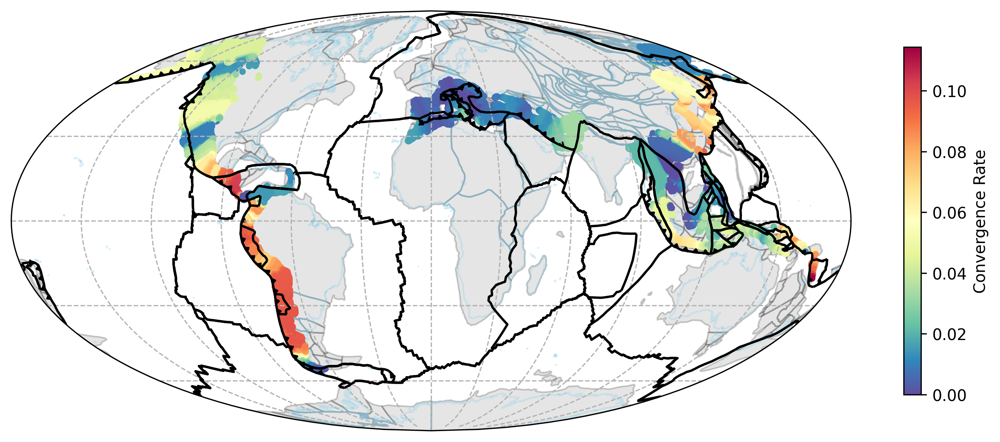

In [29]:
column_name="Convergence Rate"
kwaargs={'cmap':'Spectral_r','label':f'{column_name}','figsize':(12,8)}
plotgdf(gdf_points, gplot,mollweide=True,column=column_name,quick=False,cbar=True,**kwaargs)

## Filtering Data Points Outside Active Subduction Margins

In [30]:
filtered_df2=gpd.read_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl4.shp")

# Explode multipolygon geometries into individual polygons
filtered_df2_exploded = filtered_df2.explode(index_parts=False)

# Ensure both GeoDataFrames have the same CRS
gdf_points = gdf_points.to_crs(DEFAULT_CRS)
filtered_df2_exploded = filtered_df2_exploded.to_crs(DEFAULT_CRS)

if "index_right" in gdf_points.columns:
    gdf_points=gdf_points.drop(columns="index_right")

if "index_right" in gdf_points.columns:
    filtered_df2_exploded=filtered_df2_exploded.drop(columns="index_right")


# Perform the spatial join using the 'intersects' predicate
filtered_data = gpd.sjoin(gdf_points, filtered_df2_exploded, how='left', predicate='intersects')

# Filter out points that do not intersect with any polygon
filtered_data = filtered_data.dropna(subset=['index_right'])

# Get the filtered gdf_points with overlapping geometries
filtered_gdf_points = gdf_points[gdf_points.index.isin(filtered_data.index)]

# Visualize the result
# print(filtered_gdf_points)


<GeoAxes: >

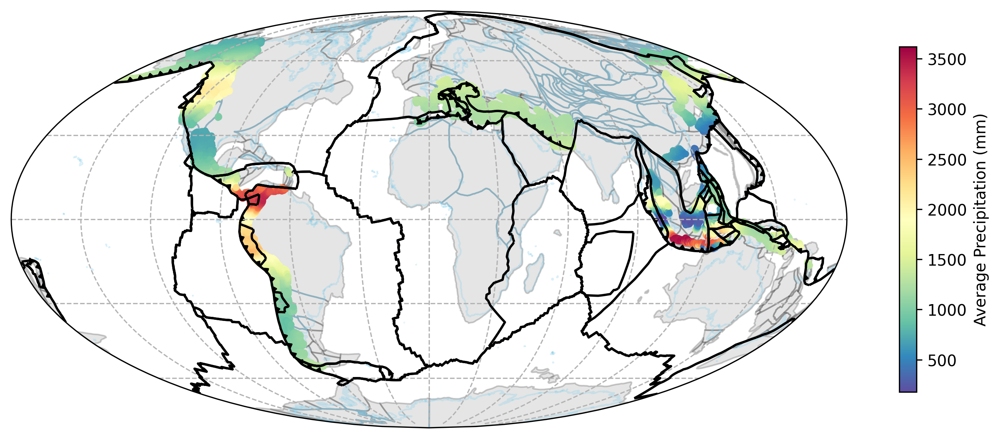

In [98]:
gdf_points=filtered_gdf_points.set_crs("EPSG:4326")
kwaargs={'cmap':'Spectral_r','label':f'Average Precipitation (mm)','figsize':(12,8)}
# plotgdf(gdf_points,mollweide=True,column="Subduction Volume Rate")
plotgdf(gdf_points, model=PK.model,mollweide=True,column="Precipitation",gplot=gplot,quick=False,cbar=True,**kwaargs)
# plotg

# Define Mantle Convection Parameters

This section of code will read all the input parameters for mantle convection model

In [31]:
# Input Files 
MANTLE_MODEL_NAME=PARAMS['InputFiles']['mantle_convection']['model_name']
MANTLE_MODEL_DIR = PARAMS['InputFiles']['mantle_convection']['model_dir']  ## plate model
MANTLE_topology_filenames =[f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['mantle_convection']['topology_files']]
MANTLE_rotation_filenames = [f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['mantle_convection']['rotation_files']]

MANTLE_depths= PARAMS['InputFiles']['mantle_convection']['depth']
MANTLE_vel_folder=PARAMS['InputFiles']['mantle_convection']['new_vel_folder']
MANTLE_temp_folder=PARAMS['InputFiles']['mantle_convection']['new_temp_folder']

MANTLE_org_vel=PARAMS['InputFiles']['mantle_convection']['original_vel_folder']
MANTLE_org_temp=PARAMS['InputFiles']['mantle_convection']['original_temp_folder']


MANTLE_velx_folder=PARAMS['InputFiles']['mantle_convection']['new_velx_folder']
MANTLE_org_velx=PARAMS['InputFiles']['mantle_convection']['original_velx_folder']

MANTLE_vely_folder=PARAMS['InputFiles']['mantle_convection']['new_vely_folder']
MANTLE_org_vely=PARAMS['InputFiles']['mantle_convection']['original_vely_folder']

MANTLE_visc_folder=PARAMS['InputFiles']['mantle_convection']['new_visc_folder']
MANTLE_org_visc=PARAMS['InputFiles']['mantle_convection']['original_visc_folder']

MANTLE_td_folder=PARAMS['InputFiles']['mantle_convection']['new_temp_dev_folder']
MANTLE_org_td=PARAMS['InputFiles']['mantle_convection']['original_temp_dev_folder']


print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print("Reading input file..... \n")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"Mantle Convection Plate Model: {MANTLE_MODEL_NAME} \n")
print(f"Mantle Convection Plate Model Directory: {MANTLE_MODEL_DIR} \n")

print(f"Mantle Convection Velocity: {MANTLE_vel_folder} \n")
print(f"Mantle Convection Temperature: {MANTLE_temp_folder} \n")

print(f"Mantle Convection Velocity: {MANTLE_org_vel} \n")
print(f"Mantle Convection Temperature: {MANTLE_org_temp} \n")

print(f"Mantle Convection Depths: {MANTLE_depths} \n")

print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– \n")

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Reading input file..... 

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Mantle Convection Plate Model: Zahirovic_etal_2022_GDJ_NNR 

Mantle Convection Plate Model Directory: ../../../PlateReconstruction 

Mantle Convection Velocity: ../../../Paleotopography/vz_dimensional 

Mantle Convection Temperature: ../../../Paleotopography/temp_dimensional 

Mantle Convection Velocity: ../../../CITCOMSGeodynamics/vz_dimensional 

Mantle Convection Temperature: ../../../CITCOMSGeodynamics/temp_dimensional 

Mantle Convection Depths: [16, 31, 47, 62, 140, 155, 171, 186, 202, 217, 233, 268, 293, 323, 357, 396, 439, 487, 540, 597, 660, 726, 798, 874, 954, 1040] 

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 



In [32]:
MT=MantleParameters(original_folder=MANTLE_org_temp,
                    new_folder=MANTLE_temp_folder,
                    parameter_type="Mantle_Temp", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
VZ=MantleParameters(original_folder=MANTLE_org_vel,
                    new_folder=MANTLE_vel_folder,
                    parameter_type="Mantle_Velocity", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
VX=MantleParameters(original_folder=MANTLE_org_velx,
                    new_folder=MANTLE_velx_folder,
                    parameter_type="Mantle_Velocity_X", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

VY=MantleParameters(original_folder=MANTLE_org_vely,
                    new_folder=MANTLE_vely_folder,
                    parameter_type="Mantle_Velocity_Y", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

VISC=MantleParameters(original_folder=MANTLE_org_visc,
                    new_folder=MANTLE_visc_folder,
                    parameter_type="Viscocity", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
TD=MantleParameters(original_folder=MANTLE_org_td,
                    new_folder=MANTLE_td_folder,
                    parameter_type="Temp_Dev", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

Created directory: ../../../Paleotopography/temp_dimensional
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Created directory: ../../../Paleotopography/vz_dimensional
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Created directory: ../../../Paleotopography/vx_dimensional
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Created directory: ../../../Paleotopography/vy_dimensional
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Created directory: ../../../Paleotopography/visc
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Created directory: ../../../Paleotopography/temp_deviation
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute

### Interpolate Mantle Convection Data at Each Timestep

If mantle parameters are not available at uniform timesteps, you can use **linear interpolation** to generate values at the desired times.

> **Note:** This interpolation will produce a large amount of data. Interpolated data is **not required for training** and is mainly useful for predicting topography in deep time.

However, you may still need to run this step to **copy data in working directory and correct the CRS**. Sometimes the mantle convection grid longitude range from 0 to 360 which needs to correct to -180 to 180

If your goal is only **EBM analysis**, you do **not** need to run the interpolation for the entire time range (`FROM_TIME` to `TO_TIME`). Instead, select a **smaller time window** to save computation and storage.

To enable this functionality, uncomment the **MT** and **Vz** class definitions below.


In [33]:
warnings.filterwarnings("ignore", category=UserWarning)
MT=MantleParameters(original_folder=MANTLE_org_temp,
                    new_folder=MANTLE_temp_folder,
                    parameter_type="Mantle_Temp", 
                    depths=MANTLE_depths, 
                    starttime=0,
                    endtime=10,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
VZ=MantleParameters(original_folder=MANTLE_org_vel,
                    new_folder=MANTLE_vel_folder,
                    parameter_type="Mantle_Velocity", 
                    depths=MANTLE_depths, 
                    starttime=0,
                    endtime=10,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

MT.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
VZ.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# VX.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# VY.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# VISC.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# TD.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)

Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'


/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to S

Created directory: ../../../Paleotopography/temp_dimensional/0Created directory: ../../../Paleotopography/temp_dimensional/0

Created directory: ../../../Paleotopography/temp_dimensional/0
Created directory: ../../../Paleotopography/temp_dimensional/0
Created directory: ../../../Paleotopography/temp_dimensional/0
Created directory: ../../../Paleotopography/temp_dimensional/0
Created directory: ../../../Paleotopography/temp_dimensional/0
Created directory: ../../../Paleotopography/temp_dimensional/6
Created directory: ../../../Paleotopography/temp_dimensional/10
Created directory: ../../../Paleotopography/temp_dimensional/1
Created directory: ../../../Paleotopography/temp_dimensional/2
Created directory: ../../../Paleotopography/temp_dimensional/3
Created directory: ../../../Paleotopography/temp_dimensional/4
Created directory: ../../../Paleotopography/temp_dimensional/5
Interpolation completed from 0 Ma to 6 Ma completed.
Created directory: ../../../Paleotopography/temp_dimensional/7
C

# Extracting the Mantle Convection Grid


In [34]:
mean_params=filtered_gdf_points.drop(columns=['geometry'])

In [35]:
reconstruction_time=0
TrainingData=MT.get_mantle_parameters(mean_params,reconstruction_time, depth_wise=True,n_jobs=parallel) ## getting mantle temp
TrainingData=VZ.get_mantle_parameters(TrainingData,reconstruction_time, depth_wise=True,n_jobs=parallel) ## getting vertical mantle vel


In [36]:
## checking if the data is fetched correctly from file
TrainingData['Mantle_Velocity_202']

0        -0.223331
1        -0.223331
2        -0.223331
3        -0.223331
4        -0.419469
            ...   
145491    0.841013
145492    0.680021
145493    0.621790
145494    0.621790
145495    0.621790
Name: Mantle_Velocity_202, Length: 111124, dtype: float32

### Calculating Mean Upper Mantle Vertical Velocity and Temperature

In [37]:
features=TrainingData.copy()
col2rm=[]
depths=[]
for depth in MANTLE_depths:
    col2rm.append(f'Mantle_Temp_{depth}')
    col2rm.append(f'Mantle_Velocity_{depth}')
    
    if (depth>200 and depth<=440):
        if depth==202:
            features['Mantle Temperature']=features[f'Mantle_Temp_{depth}']
            features['Mantle Velocity']=features[f'Mantle_Velocity_{depth}'] 
        else:  
            features['Mantle Temperature']=features['Mantle Temperature']+features[f'Mantle_Temp_{depth}']
            features['Mantle Velocity']=features['Mantle Velocity']+features[f'Mantle_Velocity_{depth}']
        depths.append(depth)
    else:
        continue

    
features['Mantle Temperature']=features['Mantle Temperature']/len(depths)
features['Mantle Velocity']=features['Mantle Velocity']/len(depths)

In [38]:
features = features.drop(col2rm, axis=1)
features["Migration Rate"]=features["Migration Rate"]*1e2 # in cm/yr 
features["Trench Distance"]=features["Trench Distance"]/1e3 # in km 

In [39]:
for i, col in enumerate(features.columns, start=1):
    print(f"{i}. {col}")


1. Latitude
2. Longitude
3. Trench Distance
4. Trench Latitude
5. Trench Longitude
6. Convergence Rate
7. Migration Rate
8. Subduction Velocity
9. Obliquity Angle
10. Subduction Normal Angle
11. Subduction Length
12. Subduction Plate Velocity
13. Subduction Plate Obliquity
14. vratio
15. Nearest Trench Edge
16. Start Edge Trench
17. Convergence Velocity Orthogonal
18. Convergence Velocity Parallel
19. Trench Velocity Orthogonal
20. Trench Velocity Parallel
21. Subducting Velocity Orthogonal
22. Subducting Velocity Parallel
23. Subducting Plate ID
24. Trench Plate ID
25. Subduction Volume Rate
26. Plate Thickness
27. Subduction Flux
28. Time
29. Precipitation
30. Mantle Temperature
31. Mantle Velocity


In [40]:
## select columns for Multivariate Analysis¶
columns_data=['Convergence Rate', 'Migration Rate',
       'Subduction Velocity', 'Obliquity Angle', 'Subduction Normal Angle',
       'Subduction Length', 'Subduction Plate Velocity',
       'Subduction Plate Obliquity', 'vratio', 'Nearest Trench Edge',
       'Start Edge Trench', 'Convergence Velocity Orthogonal',
       'Convergence Velocity Parallel', 'Trench Velocity Orthogonal',
       'Trench Velocity Parallel', 'Subducting Velocity Orthogonal',
       'Subducting Velocity Parallel', 'Subduction Volume Rate', 'Plate Thickness',
        'Trench Distance', 'Precipitation',
       'Mantle Temperature', 'Mantle Velocity','Elevation']

# Sampling Elevation for Multivariate Analysis

In [41]:
ETopo=BhuRaster(folder_location=ETOPO_FILE,Raster_Type=ETOPO_Type)
features=ETopo.get_parameters(features)
features=features[columns_data]

## Visualizing Correlations

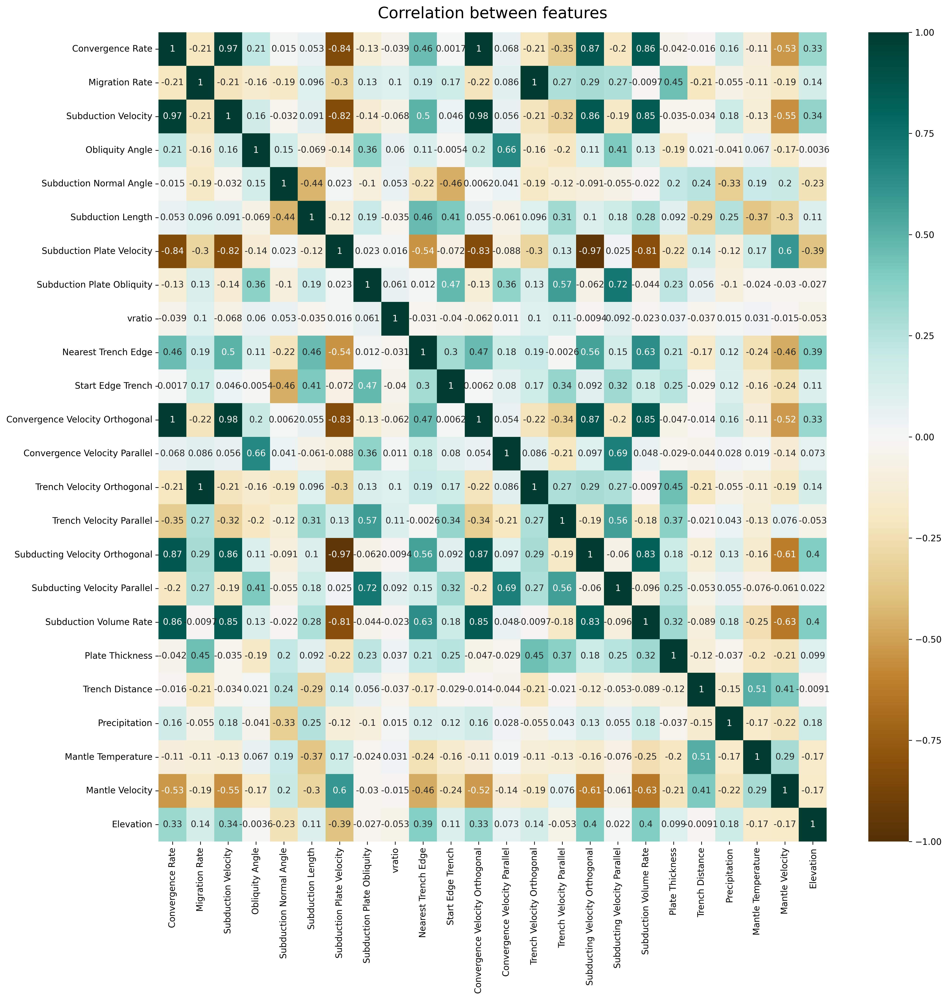

In [42]:
create_directory_if_not_exists(f"{OUTPUT_FOLDER}/Figure")
features_exp=features.copy
# mask = np.triu(np.ones_like(features.corr(), dtype=bool))
plt.figure(figsize=(16, 16),dpi=300)
heatmap = sns.heatmap(features.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
# heatmap = sns.heatmap(features.corr(), mask=mask, vmin=-1, vmax=1, annot=False, cmap='BrBG')
heatmap.set_title('Correlation between features', fontdict={'fontsize':18}, pad=16)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Correlation_Heat_Map_All.png")
plt.show()

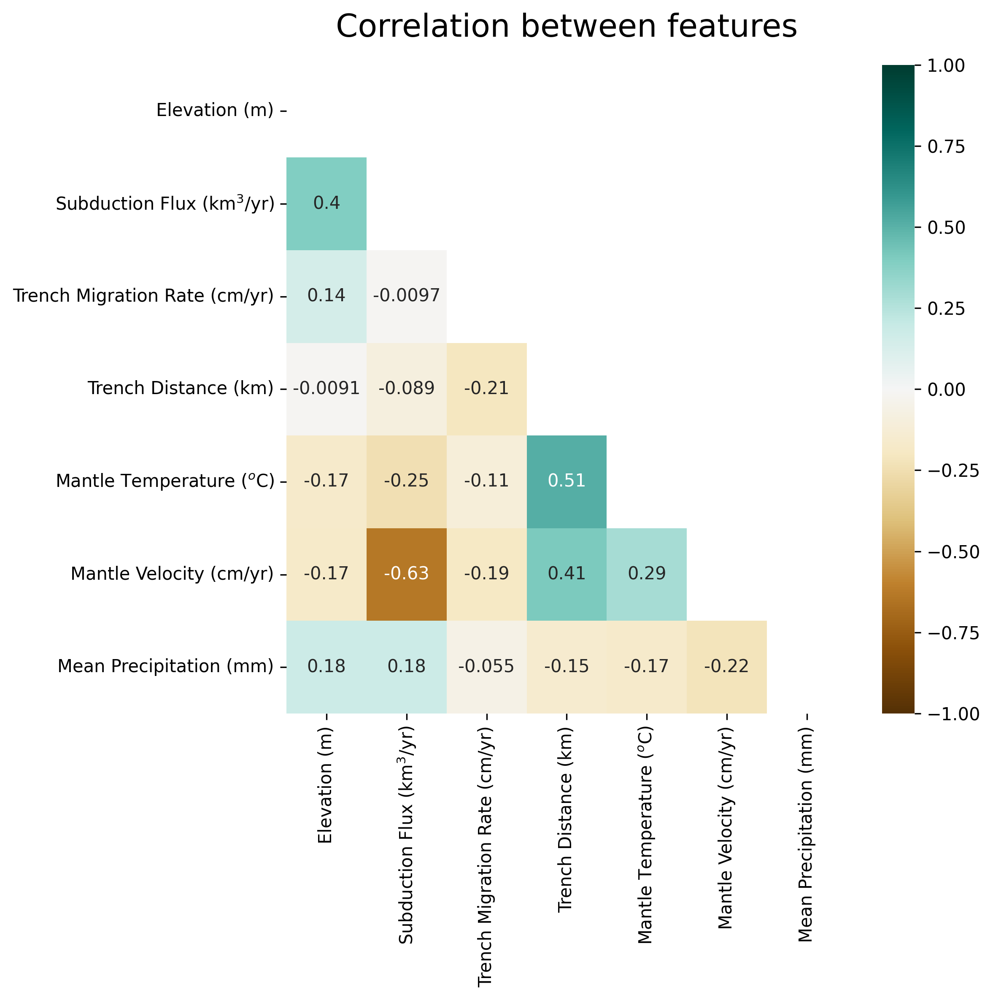

In [43]:
featuresc=pd.DataFrame()
featuresc['Elevation (m)']= features['Elevation']
featuresc['Subduction Flux (km$^3$/yr)']=features['Subduction Volume Rate']
featuresc['Trench Migration Rate (cm/yr)']=features['Migration Rate']
featuresc['Trench Distance (km)']=features['Trench Distance']
featuresc['Mantle Temperature ($^o$C)']=features['Mantle Temperature']
featuresc['Mantle Velocity (cm/yr)']=features['Mantle Velocity']
featuresc['Mean Precipitation (mm)']=features['Precipitation']
mask = np.triu(np.ones_like(featuresc.corr(), dtype=bool))
plt.figure(figsize=(8, 8),dpi=300)
heatmap = sns.heatmap(featuresc.corr(), mask=mask, vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation between features', fontdict={'fontsize':18}, pad=16)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Correlation_Heat_Map_selected.png")
plt.show()

<Figure size 5400x7200 with 0 Axes>

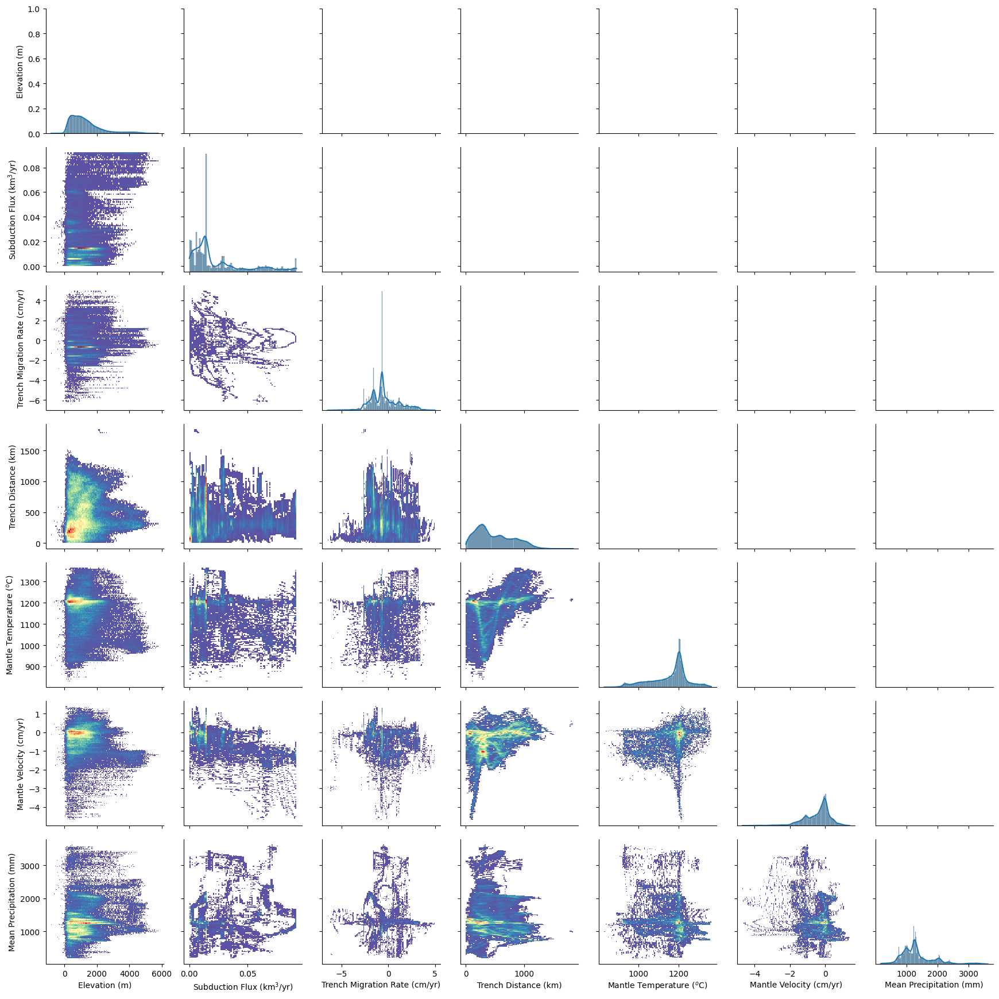

In [44]:
plt.figure(figsize=(18, 24),dpi=300)
g = sns.PairGrid(featuresc)
# g.map_lower(sns.kdeplot, fill=True,cmap="Spectral_r")
g.map_lower(sns.histplot, fill=True,cmap="Spectral_r")
g.map_diag(sns.histplot, kde=True)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Histogram.png")
plt.show()

# Plotting All Features / Parameters for Validation

This section visualizes all features and parameters to verify their correctness and consistency before further analysis or modeling.


In [137]:
gdf_points=gpd.GeoDataFrame(featuresc,geometry=gpd.points_from_xy(TrainingData['Longitude'],TrainingData['Latitude']))
gdf_points=gdf_points.set_crs(DEFAULT_CRS)

In [138]:
gdf_points['Longitude']=TrainingData['Longitude']
gdf_points['Latitude']=TrainingData['Latitude']

In [140]:
gdf_points

,Elevation (m),Subduction Flux (km$^3$/yr),Trench Migration Rate (cm/yr),Trench Distance (km),Mantle Temperature ($^o$C),Mantle Velocity (cm/yr),Mean Precipitation (mm),geometry,Longitude,Latitude
0,829.716492,0.027602,2.049141,659.419160,1259.969360,-0.494672,1248.869719,POINT (61.1509 32.5124),61.1509,32.5124
1,825.992310,0.027571,2.049573,669.036626,1259.969360,-0.494672,1243.476793,POINT (61.1509 32.6124),61.1509,32.6124
2,960.218201,0.027928,1.998728,664.131557,1259.969360,-0.494672,1248.827427,POINT (61.2509 32.5124),61.2509,32.5124
3,910.482483,0.027704,2.023247,673.756418,1259.969360,-0.494672,1243.470421,POINT (61.2509 32.6124),61.2509,32.6124
4,676.501099,0.028476,1.925657,639.245243,1219.933960,-0.649845,1251.189189,POINT (61.3509 32.2124),61.3509,32.2124
...,...,...,...,...,...,...,...,...,...,...
145491,38.126770,0.025780,-4.259435,467.957548,1202.191895,0.196916,1413.841145,POINT (152.7506 -10.6606),152.7506,-10.6606
145492,131.765366,0.023344,-4.754705,479.053212,1196.007202,0.277144,1412.124224,POINT (153.4506 -11.4606),153.4506,-11.4606
145493,59.374172,0.027501,-4.241392,425.558386,1193.675659,-0.055060,1447.481094,POINT (154.0506 -11.3606),154.0506,-11.3606
145494,121.880447,0.029823,-4.269139,418.299324,1193.675659,-0.055060,1451.787275,POINT (154.1506 -11.3606),154.1506,-11.3606


/var/folders/qr/01bxwnvn05s319mx5c07sd7w0000gp/T/ipykernel_97087/3649555440.py:53: DeprecationWarning: Deprecated! The 'plot_ridges_and_transforms' function will be removed in the future GPlately releases. Update your workflow to use the 'plot_ridges' and 'plot_transforms' functions instead, otherwise your workflow will not work with the future GPlately releases.


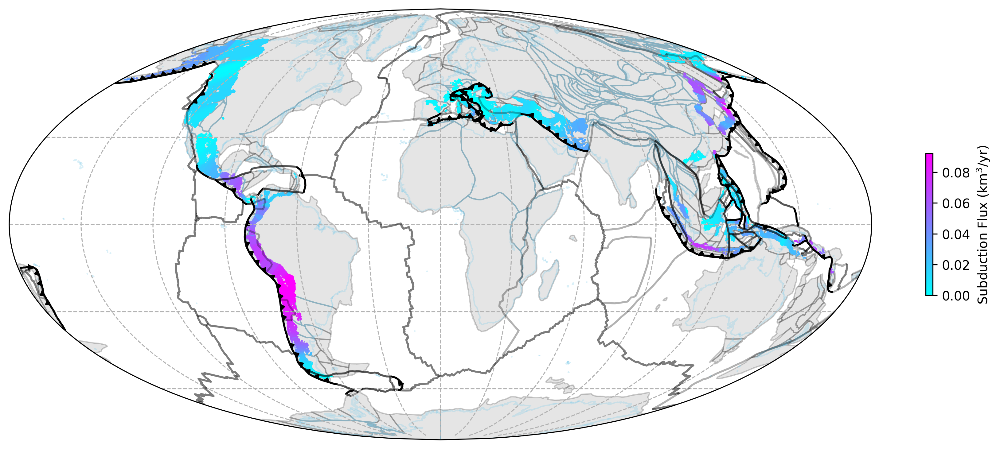

In [153]:
column="Subduction Flux (km$^3$/yr)"
kwaargs={'cmap':'cool','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1}
plotgdf(gdf_points,gplot=gplot,mollweide=True,column=column,cbar=True,quick=False,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Subduction Flux Rate.png")
plt.show()

Plotting


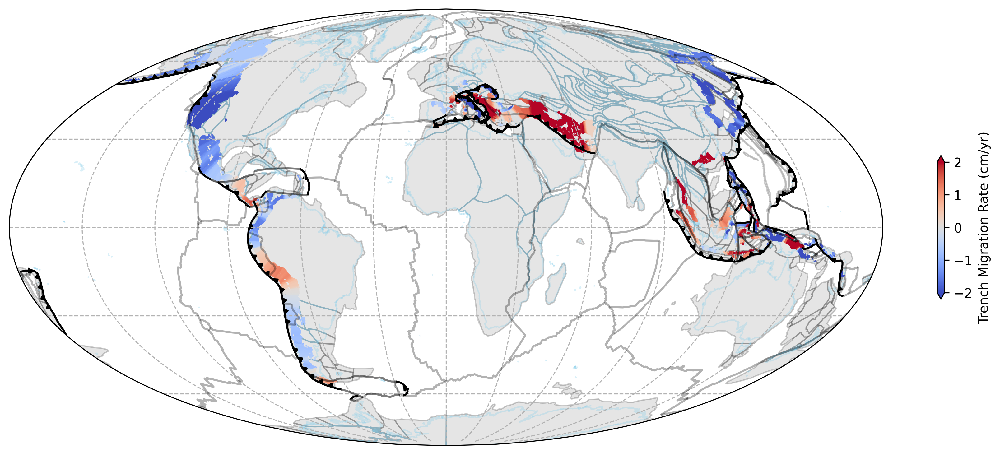

In [167]:
column='Trench Migration Rate (cm/yr)'
kwaargs={'cmap':'coolwarm','label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-2,'vmax':2,'extend':'both','markersize':0.1}
plotgdf(gdf_points,model=PK.model,quick=False,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Trench Migration Rate.png")
plt.show()

Plotting


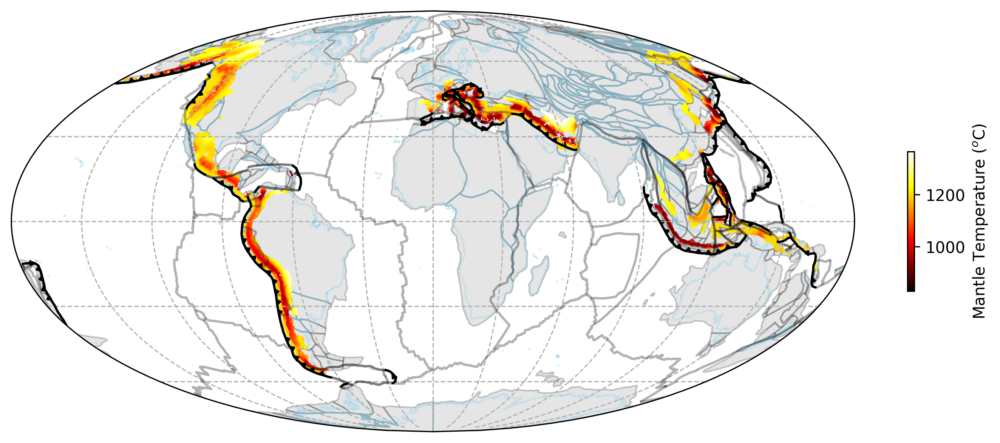

In [168]:
column='Mantle Temperature ($^o$C)'
kwaargs={'cmap':'hot','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1}
plotgdf(gdf_points,model=PK.model,quick=False,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Mantle Temperature.png")
plt.show()

Plotting


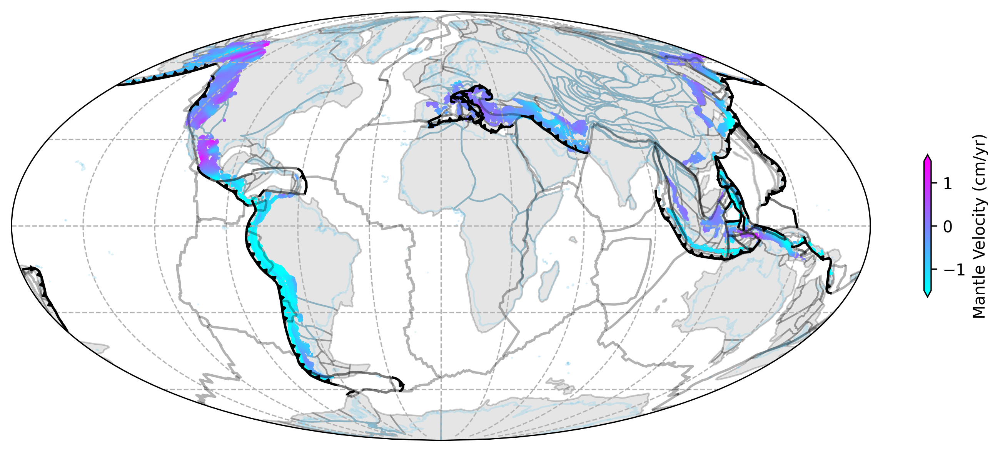

In [169]:
column='Mantle Velocity (cm/yr)'
kwaargs={'cmap':'cool','label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-1.5,'vmax':1.5,'extend':'both','markersize':0.1}
plotgdf(gdf_points,model=PK.model,mollweide=True,quick=False,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Mantle Velocity.png")

Plotting


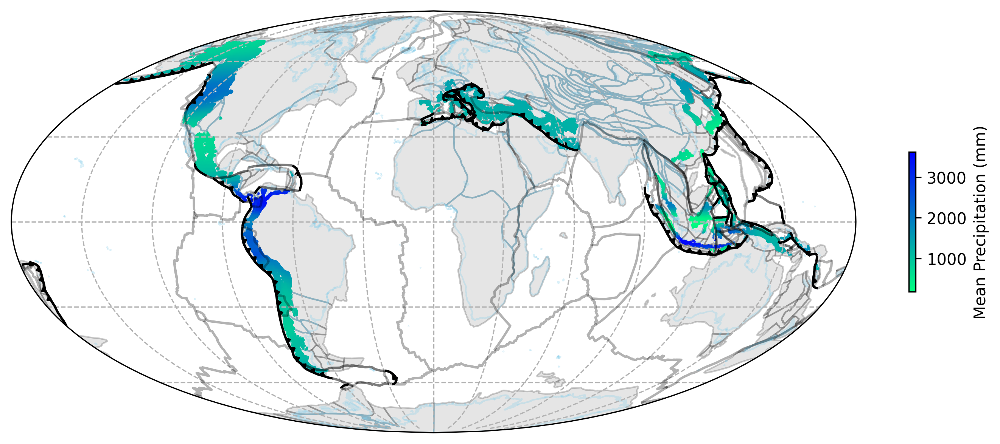

In [170]:
column='Mean Precipitation (mm)'
kwaargs={'cmap':'winter_r','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1}
plotgdf(gdf_points,model=PK.model,mollweide=True,quick=False,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Precipitation.png")

Plotting


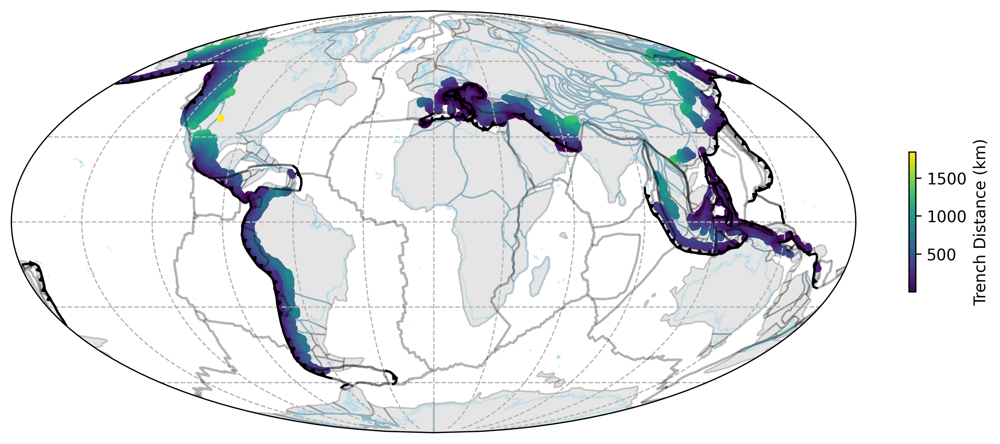

In [171]:
column='Trench Distance (km)'
kwaargs={'cmap':'viridis','label':f'{column}','figsize':(12,8),'shrink':0.2}
plotgdf(gdf_points,model=PK.model,mollweide=True,quick=False,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Trench Distance.png")
plt.show()